<a href="https://colab.research.google.com/github/jmestanza/time_stretching/blob/master/flanger_bug_fix_y_refactor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
%cd /content
from IPython.display import clear_output

#imports
#!pip install librosa
!pip install webrtcvad
import webrtcvad
!pip install --upgrade librosa
import librosa 
import scipy
import numpy as np
from IPython.display import Audio
import matplotlib.pyplot as plt
from math import ceil 
import matplotlib.patches as mpatches

clear_output()

In [0]:
#local modules
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/detect_pitch.py
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/modified_psola.py
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/vad.py

#audios
!wget "https://raw.githubusercontent.com/vicaub/Pitch-Estimation-and-Voicing-Detection/master/data/fda_ue/rl047.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/harry_potter_es.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/hunger_games_en.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/shh.wav"

clear_output()

In [0]:
from modified_psola import modified_psola
from detect_pitch import get_fundamental_frequency
from vad import float2pcm, pcm2float, frame_generator, join_vad_frames, get_vad_frames
from vad import Frame
from scipy import signal

clear_output()

## Escuchamos el input

In [135]:
fs = 48000

audio = "/content/hunger_games_en.wav"
Audio(data=audio, rate=fs)

In [0]:
def plot_voiced_regs(regions, is_frame_speech, audio_f):
  plt.figure(figsize=(20, 5))
  green_patch = mpatches.Patch(color='green', label='sonoro')
  red_patch = mpatches.Patch(color='red', label='no-sonoro')
  plt.legend(handles=[green_patch, red_patch])
  plt.xlabel("muestras")
  plt.ylabel("amplitud")

  #ploteo regiones sonoras y no sonoras
  for i,reg in enumerate(regions):
    start,end = reg  
    if start < 1000000 and end < 1000000:
      if(is_frame_speech[start] == True):
        # plt.vlines(x=start, ymin=0, ymax=1.0)
        plt.hlines(y=0.65, xmin=start, xmax=end, linewidth=3, colors='g')
        # plt.vlines(x=end, ymin=0, ymax=1.0)
      else:
        plt.hlines(y=0.65, xmin=start, xmax=end, linewidth=3, colors='r')

    
  plt.plot(audio_f[:1000000])
  plt.grid()
  plt.figure()


def separate_regions(is_voiced):
    regions = []
    for i in range(len(is_voiced)):
        if i == len(is_voiced) - 1:
            regions.append([start,i])
        elif i ==0:
            start = 0
    else:
        curr_region = is_voiced[i] # si es sonoro o no sonoro
        if curr_region != is_voiced[i-1]:
            regions.append([start,i-1]) # pusheo la region anterior
        start = i
    return regions

def get_float_and_int_audio(audio_path,fs, cut_audio = None):
    audio_f, _ = librosa.load(audio_path, sr=fs, mono=True)
    audio_i = float2pcm(audio_f, dtype="int32")
    if cut_audio != None:
        audio_f = audio_f[:int(cut_audio*fs)]
        audio_i = audio_i[:int(cut_audio*fs)]
    return audio_f, audio_i

def lpc_filtering(regions, audio_f):
    lpc_coeffs = []
    error = []
    for start, end in regions:
        a = librosa.lpc(audio_f[start:end], 12)
        lpc_coeffs.append(a)
        error.extend(scipy.signal.lfilter(a, [1], audio_f[start:end]))
    error = np.array(error)
    return error, lpc_coeffs

def vad_config(audio_i, fs):
    vad = webrtcvad.Vad(3)    #0 is the least aggressive about filtering out non-speech, 3 is the most aggressive; 3 pone mas frames en no-sonoros
    #divido el audio en frames de 20 milisegundos
    frames = list(frame_generator(20, audio_i, fs))
    speech, not_speech, is_frame_speech, frame_len = get_vad_frames(frames, vad, fs)
    return speech, not_speech, is_frame_speech, frame_len

def get_regions_in_new_time(regions,speed): 
    sub_regions = []
    for i,reg in enumerate(regions):
        start,end = reg
        if i == 0: # si es el primero, inicia en 0, 
            new_start = 0
        else:  # sino empieza en el anterior final + 1
            new_start = last_end + 1
        new_end = ceil(end*(1/speed))

        sub_regions.append([new_start,new_end])
        last_end = new_end
    return sub_regions

def process_error(error, K, L, fs,percent,speed,is_voiced,regions):
    f0_idx,f0 = get_fundamental_frequency(error,is_voiced, K, L, fs)
    psola_error = modified_psola(error, f0_idx, f0,percent, speed, is_voiced, regions)
                            #(    x, f0_idx, f0, percent, speed, is_voiced, regions, unvoiced_samples=360):

    return psola_error, f0_idx, f0 

def get_noise_for_lpc(audio_f,std = 0.001):
    noise = np.random.normal(0, std, size=len(audio_f)) # media 0
    #plt.plot(samples)
    return noise+audio_f 

def get_K_and_L(T,fs):
    samples = int(T * fs) 
    L = samples//2
    K = L
    print("periodicidad minima que se puede estimar",fs/K, "Hz")
    return K, L 

def plot_three_signals(audio_original,audio_procesado,error_psola, speed,normalize = False, fill_with_zeros= False):
    if normalize:
     audio_original = librosa.util.normalize(audio_original)
     audio_procesado = librosa.util.normalize(audio_procesado)
    if fill_with_zeros:
        if speed != 1.0:
            audio_procesado = np.hstack((audio_procesado,np.zeros(len(audio_original)-len(audio_procesado))))
            error_psola = np.hstack((error_psola,np.zeros(len(audio_original)-len(error_psola))))
    time = np.linspace(0, len(audio_original)//fs, len(audio_original))
    fig = plt.figure(figsize=(15,5))
    ax = fig.add_subplot(311)
    ax1 = fig.add_subplot(312)
    ax.set_title('Audio en inglés x{}'.format(speed))
    ax.plot(time, audio_original, 'b') 
    ax1.plot(time[:len(audio_procesado)],audio_procesado, 'g')
    ax1.set_xlabel("tiempo (s)")
    ax.set_ylabel("speed = 1.0")
    ax1.set_ylabel('speed = {}'.format(speed))

    ax2 = fig.add_subplot(313)
    ax2.set_xlabel("tiempo (s)")
    ax2.set_ylabel('error'.format(speed))
    ax2.plot(time[:len(error_psola)],error_psola, "r")
    
    plt.show()


periodicidad minima que se puede estimar 100.0 Hz


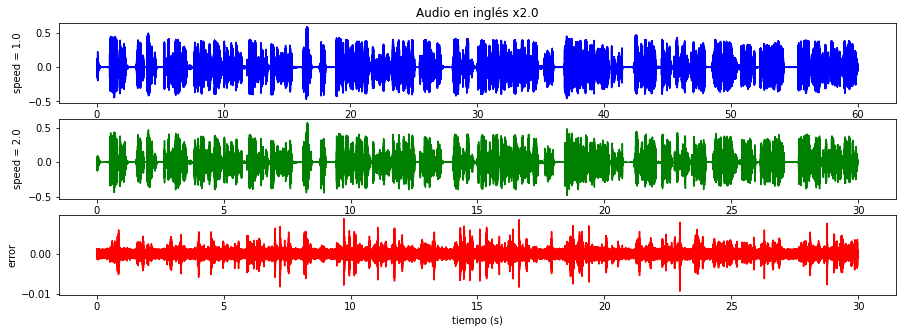

In [144]:
# este SpeedUp agrega ruido a la senial para obtener LPC
# y despues filtra la senial + ruido,
# POSIBLES MEJORAS: 
# 1) se podria filtrar solo  la senial en vez de senial mas ruido pero quedarse
# de todas formas con los coeficientes lpc esos.
# 2) Aplicar ventanas de 20 ms para hacer LPC short time en vez de separar
# por regiones sonoras y no sonoras

def speed_up(audio_path, speed, sample_rate, T=20*1e-3):
    audio_f, audio_i = get_float_and_int_audio(audio_path,fs, cut_audio = None) # audio_i lo necesita el VAD
    audio_f = get_noise_for_lpc(audio_f, std=1e-5)

    K , L = get_K_and_L(T,fs)

    speech, not_speech, is_voiced, frame_len = vad_config(audio_i, fs)
    
    regions = separate_regions(is_voiced)
    regions_lpc = regions.copy()
    error, lpc_coeffs = lpc_filtering(regions_lpc, audio_f) 
    percent = 0.5

    psola_error, f0_idx, f0 =  process_error(error, K, L, fs,percent,speed,is_voiced,regions)
    
    sub_regions = get_regions_in_new_time(regions_lpc,speed)

    voiced_filt = []            

    for i, sub_reg in enumerate(sub_regions):      
        start, end = sub_reg
        voiced_filt.extend(scipy.signal.lfilter([1], lpc_coeffs[i] , psola_error[start:end]))
    voiced_filt = np.array(voiced_filt)
    return voiced_filt, psola_error, error, audio_f 

speed = 2.0
audio_final, psola_err, err, audio_original = speed_up(audio, speed, fs)
plot_three_signals(audio_original,audio_final,psola_err, speed,normalize = False, fill_with_zeros=False)
Audio(data=audio_final, rate=fs)

periodicidad minima que se puede estimar 100.0 Hz


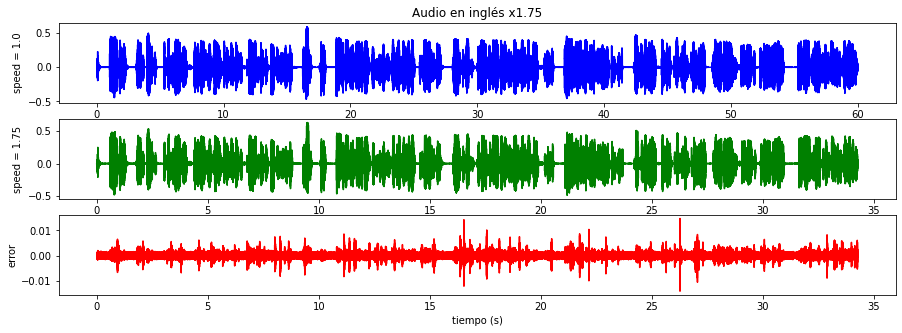

In [149]:
speed = 1.75
audio_final, psola_err, err, audio_original = speed_up(audio, speed, fs)
plot_three_signals(audio_original,audio_final,psola_err, speed,normalize = False, fill_with_zeros=False)
Audio(data=audio_final, rate=fs)

periodicidad minima que se puede estimar 100.0 Hz


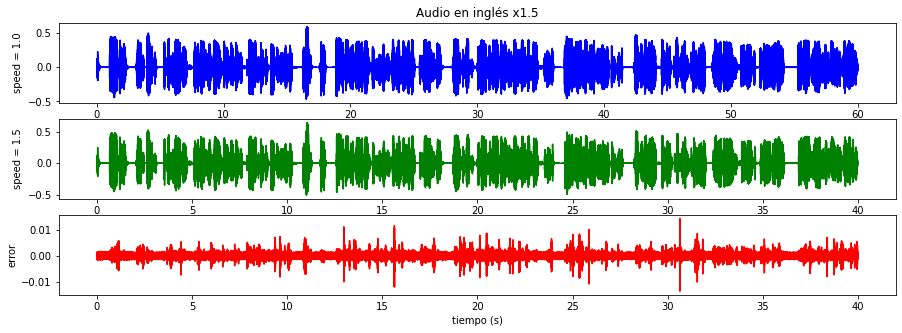

In [147]:
speed = 1.5
audio_final, psola_err, err, audio_original = speed_up(audio, speed, fs)
plot_three_signals(audio_original,audio_final,psola_err, speed,normalize = False, fill_with_zeros=False)
Audio(data=audio_final, rate=fs)

periodicidad minima que se puede estimar 100.0 Hz


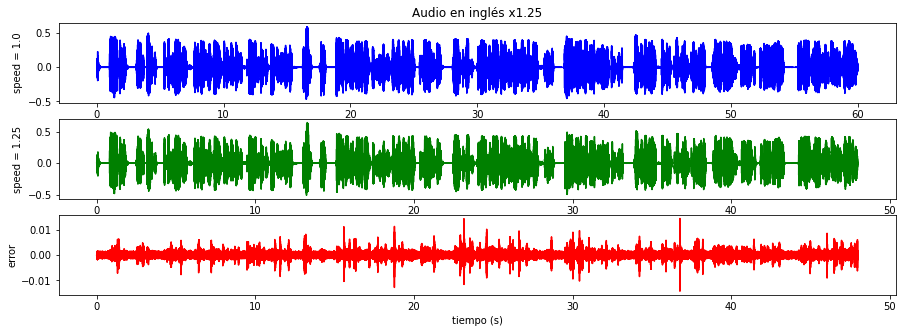

In [148]:
speed = 1.25
audio_final, psola_err, err, audio_original = speed_up(audio, speed, fs)
plot_three_signals(audio_original,audio_final,psola_err, speed,normalize = False, fill_with_zeros=False)
Audio(data=audio_final, rate=fs)

## Vamos a hacer LPC short time 

In [0]:
def LPC_short_time_filter(audio_f,window_size, apply_hamming = True):
    leap = window_size // 2
    lpc_coeffs = []
    cnt_leaps = len(audio_f) // leap 
    error = np.zeros(len(audio_f))

    for i in range(cnt_leaps):
        curr_rw = audio_f[i*leap : (i+1)*leap+leap] # overlap de 50%
        if apply_hamming:
            hamming_w = np.hamming(len(curr_rw))
            curr_rw *= hamming_w
        a = librosa.lpc(curr_rw, 12)
        lpc_coeffs.append(a)
        error[i*leap : (i+1)*leap+leap] += scipy.signal.lfilter(a, [1], curr_rw)
    
    return error, lpc_coeffs

def LPC_short_time_defilter(psola_err, speed, lpc_coeffs, window_size, apply_hamming = True):
    leap = window_size // 2
    cnt_leaps = len(psola_err) // leap 
    final_audio = np.zeros(len(psola_err))
    num, den = speed.as_integer_ratio() # 3 / 2 = > num 3 , den 2 ;  4 1 

    new_lpc_coeffs = []
    for i in range(len(lpc_coeffs)):
        if den> i%num:
            new_lpc_coeffs.append(lpc_coeffs[i])

    for i in range(cnt_leaps):
        curr_rw = psola_err[i*leap : (i+1)*leap+leap] # overlap de 50%
        if apply_hamming:
            hamming_w = np.hamming(len(curr_rw))
            curr_rw *= hamming_w
        final_audio[i*leap : (i+1)*leap+leap] += scipy.signal.lfilter([1], new_lpc_coeffs[i], curr_rw)
    return final_audio

periodicidad minima que se puede estimar 100.0 Hz


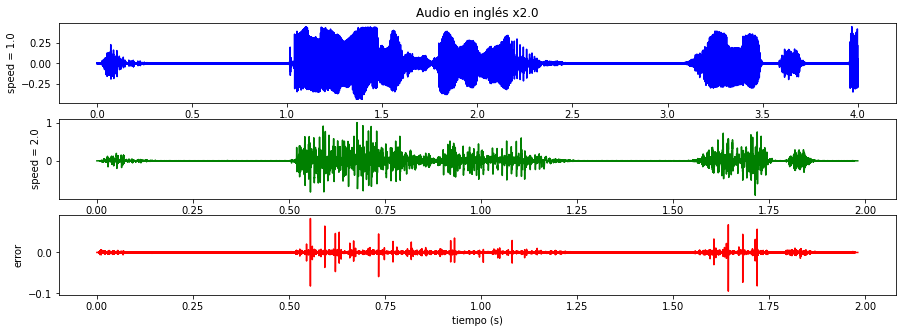

In [143]:
# este SpeedUp agrega ruido a la senial para obtener LPC
# y despues filtra la senial + ruido,
# POSIBLES MEJORAS: 
# 1) se podria filtrar solo  la senial en vez de senial mas ruido pero quedarse
# de todas formas con los coeficientes lpc esos.

def speed_up_with_LPC_ST(audio_path, speed, sample_rate, T=20*1e-3):
    audio_f, audio_i = get_float_and_int_audio(audio_path,fs, cut_audio = 4) # audio_i lo necesita el VAD
    audio_f = get_noise_for_lpc(audio_f, std=1e-3)

    K , L = get_K_and_L(T,fs)

    speech, not_speech, is_voiced, frame_len = vad_config(audio_i, fs)
    
    regions = separate_regions(is_voiced)
    regions_lpc = regions.copy()

    window_size = int(25e-3*fs)
    error, lpc_coeffs = LPC_short_time_filter(audio_f,window_size, apply_hamming = False)
    
    percent = 0.5
    psola_error, f0_idx, f0 =  process_error(error, K, L, fs,percent,speed,is_voiced,regions)

    voiced_filt =  LPC_short_time_defilter(psola_error, speed, lpc_coeffs, window_size, apply_hamming = True)

    return voiced_filt, psola_error, error, audio_f 

speed = 2.0
audio_final, psola_err, err, audio_original = speed_up_with_LPC_ST(audio, speed, fs)
plot_three_signals(audio_original,audio_final,psola_err, speed,normalize = False, fill_with_zeros=False)
Audio(data=audio_final, rate=fs)

## Conclusiones hasta ahora

* Filtrado LPC provoca picos extraños en la señal 

* Filtrado LPC SHORT TIME no mejora respecto al que propusimos que era por separacion de regiones sonoras (LPC SHORT TIME toma ventanas)

Como se hizo LPC SHORT TIME:

Filtrado:

Agarre una ventana rectangular, la filtre con el error de prediccion y eso lo puse como error cada 20ms y con overlap de 50%.

Defiltrado del error de psola:

Ventanee con hamming overlap de 50%, la filtre con el inverso del filtro de error de prediccion.

*  Bug de volumen en PSOLA